In [1]:
# PYTHON IMPORTS
import os, copy, math, re
from tqdm.notebook import trange, tqdm

# IMAGE IMPORTS 
from PIL import Image

# DATA IMPORTS 
import random, h5py, glob
import numpy as np

# PLOTTING
import matplotlib.pyplot as plt
import matplotlib.cm as cm

# SHAPES IMPORTS
import shapely
import geopandas as gpd
from shapely.ops import unary_union
from shapely.geometry import LineString, Polygon, Point

# MY OWN CLASSES
from FindGrid import *

# OCR libraries
import pytesseract
from fuzzywuzzy import fuzz

# INITIALIZE
t_path = r'C:\Users\fhacesga\AppData\Local\Programs\Tesseract-OCR\tesseract.exe'
pytesseract.pytesseract.tesseract_cmd = t_path

# PREFERENCES
Image.MAX_IMAGE_PIXELS = 933120000

C:\Users\fhacesga\Anaconda3\envs\deeplearning\lib\site-packages\fuzzywuzzy\fuzz.py:11: UserWarning: Using slow pure-python SequenceMatcher. Install python-Levenshtein to remove this warning
  warnings.warn('Using slow pure-python SequenceMatcher. Install python-Levenshtein to remove this warning')


In [2]:
data_dir      = r"C:\Users\fhacesga\OneDrive - University Of Houston\AAA_RECTDNN\data/"
prep_folder   = f"{data_dir}TileLocator/in_prepped_v2/"

C:\Users\fhacesga\Anaconda3\envs\deeplearning\lib\site-packages\torchvision\models\_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and may be removed in the future, "
C:\Users\fhacesga\Anaconda3\envs\deeplearning\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


  0%|          | 0/5 [00:00<?, ?it/s]

C:\Users\fhacesga\Desktop\FIRMsDigitizing\RECTDNN\TileLocator.py:93: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  output = self.softmax(output)
C:\Users\fhacesga\Desktop\FIRMsDigitizing\RECTDNN\SquareLocator.py:94: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  output = self.softmax(output)
C:\Users\fhacesga\Desktop\FIRMsDigitizing\RECTDNN\FindGrid.py:317: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for linestring in linestrings:


  0%|          | 0/262 [00:00<?, ?it/s]

Highest Hierarchy: 1 in 4 contours


  0%|          | 0/35 [00:00<?, ?it/s]

____________________________________
['e', 'N', 'ELLINGTON', 'AIR', 'FORCE', 'BASE', '480296', '0190', 'C', 'Q_A_L']
____________________________________
['480296', '0185', 'C', 'T', 'R', 'B', '2', 'Yy', 'b']
____________________________________
['0296', '0180', 'B', '_', '4', 'S', 'vw', '__', '_', '_', 'po', 'Z', 'HaRRis', 'Counry', '054', '0', 's', 'BRAZOR', 'e', 'Q', 'n']
____________________________________
['N', 'o', '480296', '0145', 'C']
____________________________________
['rwbzss', '0165', 'B']
____________________________________
['Tty', 'of', 'South', 'S', 'de', 'Place', '0', 'BoyoY', '480296', '0155', 'C', '480296', '0160', 'B']
Found too many names! Splitting along longest sides
GEOMETRYCOLLECTION (POLYGON ((1897.001440917677 2759.499998433785, 2357 2759, 2356.622825351104 2411.999323015922, 1896.001440917677 2412.499998433785, 1897.001440917677 2759.499998433785)), POLYGON ((1896.001440917677 2412.499998433785, 1436 2413, 1436.377174648896 2760.000676984077, 1897.0014409

C:\Users\fhacesga\Desktop\FIRMsDigitizing\RECTDNN\FindGrid.py:771: ShapelyDeprecationWarning: __getitem__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return outstruct[0], outstruct[1]


____________________________________
['7', 'i', '5', 'Lo', '7', '4', 'I', '2960', '7', 'o', 'g', 'T']
____________________________________
['W', 'o', 'W', 'W']
____________________________________
['AREA', 'IOT', 'INCLUD', 'D', 'P', 'g', 'LN', 's', 'g', '480296', '0135', 'B']
____________________________________
['iy', 'T', 'o', 'o', '480296', '0130', 'C', 'J', 'g', 'Ve', 'Brady', 'o', 'Island', '1']
____________________________________
['N__', 'F', 'G', '480296', '0125', 'B', '7N']
____________________________________
['Gity', 'of', 'Hunters', 'Creek', 'Village', 'JAREA', 'NOT', 'INCLUDED', '480296', '0120', 'C', 'University', 'City', 'of', 'Wes', 'arl', 'City', 'of', 'AREA', 'NOT', 'Bellaire', 'INCLUDED', 'AREA', 'NOT']
____________________________________
['City', 'of', 'Piney', 'Point', 'R', 'Qf', 'fﬂijf', 'mi', '1aREA', 'NOT', 'Village', 'e', 'INCLUDED', '480296', '0115', 'C', 'f_', 'I', 'ral']
____________________________________
['RESERVIOR', 'T', 'd', '480296', '0110', 'Vol', '

C:\Users\fhacesga\Anaconda3\envs\deeplearning\lib\site-packages\torchvision\models\_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and may be removed in the future, "
C:\Users\fhacesga\Anaconda3\envs\deeplearning\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


  0%|          | 0/3 [00:00<?, ?it/s]

C:\Users\fhacesga\Desktop\FIRMsDigitizing\RECTDNN\TileLocator.py:93: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  output = self.softmax(output)
C:\Users\fhacesga\Desktop\FIRMsDigitizing\RECTDNN\SquareLocator.py:94: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  output = self.softmax(output)
C:\Users\fhacesga\Desktop\FIRMsDigitizing\RECTDNN\FindGrid.py:317: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for linestring in linestrings:


  0%|          | 0/28 [00:00<?, ?it/s]

Highest Hierarchy: 0 in 4 contours


  0%|          | 0/4 [00:00<?, ?it/s]

____________________________________
['480304', '0002', 'A', 'cREES', 'L9', 'FLAT', 'BANK', 'CREEK', 'N', 'B', 'I', 'Ny', 'p', 'R', 'o', 'CORPORATE', 'LMITS', 'e', 'o', 'CORP_ORATE', 'kIMLfS_r', 'OYSTER', 'F', 'AT', 'BANK', 'CREEK', 'e', 'CREEK']
____________________________________
['480304', '0001', 'A', 'WILLOW', 'WATERHOLE', 'BAYOU', 'o7', 'a0', 'et', 'w', 'CORPORATE', 'uMITS', 's', 'r', 'O', 'CORPORATE', 'LIMITS', 'L', 'AL', 'ROUTE', '223', 'American', 'l', 'MUSTANG', 'BAYOU', 'n', 'Water', 'Canal']


C:\Users\fhacesga\Anaconda3\envs\deeplearning\lib\site-packages\torchvision\models\_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and may be removed in the future, "
C:\Users\fhacesga\Anaconda3\envs\deeplearning\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


  0%|          | 0/15 [00:00<?, ?it/s]

C:\Users\fhacesga\Desktop\FIRMsDigitizing\RECTDNN\TileLocator.py:93: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  output = self.softmax(output)
C:\Users\fhacesga\Desktop\FIRMsDigitizing\RECTDNN\SquareLocator.py:94: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  output = self.softmax(output)
C:\Users\fhacesga\Desktop\FIRMsDigitizing\RECTDNN\FindGrid.py:317: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for linestring in linestrings:


  0%|          | 0/283 [00:00<?, ?it/s]

Highest Hierarchy: 0 in 4 contours


  0%|          | 0/48 [00:00<?, ?it/s]

____________________________________
['y', '48071C0675E']
____________________________________
['48071C0540E', 'E']
____________________________________
['43071C0545E', 'l', 'e']
____________________________________
['48071C0590E']
____________________________________
['48071C0S595E', 'e', 'EAST', 'BAY']
____________________________________
['48071C0525E', 'F', '_', 's', 'GALVESTON', 'BAY', 'BN', 'N', 'BN', 'I', 'BN', 'B', 'B', 'Y']
____________________________________
['48071C0530E']
____________________________________
['48071C0535E']
____________________________________
['48071C0S555E', '48071C0560E', 'UR', 'Lone', 'Oak', 'Bayou', 'LAKI', 'STEPHE', 'o']
Found too many names! Splitting along longest sides
GEOMETRYCOLLECTION (POLYGON ((6155.749897036584 6861.235550899561, 6890.218567675394 6834.444883629184, 6859.506507513182 5992.470856917964, 6118.283195568728 6019.507908213942, 6155.749897036584 6861.235550899561)), POLYGON ((6118.283195568728 6019.507908213942, 5391.287939837788 6

C:\Users\fhacesga\Desktop\FIRMsDigitizing\RECTDNN\FindGrid.py:771: ShapelyDeprecationWarning: __getitem__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return outstruct[0], outstruct[1]


____________________________________
['48071C0580E', 'ROBINSON', 'LAKE', 'E', 'NSON']
____________________________________
['48071C0585E', 'Lone', 'Tree', 'Bayou']
____________________________________
['48071C0605E', 'Oyster', 'Bayou']
____________________________________
['48071C0610E', 'W']
____________________________________
['4807102330E', 'oy', 'L', '4', 'L', '4']
____________________________________
['48071C0345E', 'e']
____________________________________
['48071C0365E']
____________________________________
['48071C0370E']
____________________________________
['48071C0390E', 'Double', 'Bayou', 'West', 'Fork']
____________________________________
['43071C0395E', 'Double', 'Bayou', 'East', 'Fork']
____________________________________
['48071C0325E']
____________________________________
['s', '48071C0335E', 'Sutton', 'Gully', 'Cedar', 'Gu', 'RAILROAD', 'avodvd', 'i']
____________________________________
['48071C0355E', 'City', 'ully', 'City', 'of', 'Baytown']
_____________________

C:\Users\fhacesga\Anaconda3\envs\deeplearning\lib\site-packages\torchvision\models\_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and may be removed in the future, "
C:\Users\fhacesga\Anaconda3\envs\deeplearning\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


  0%|          | 0/15 [00:00<?, ?it/s]

C:\Users\fhacesga\Desktop\FIRMsDigitizing\RECTDNN\TileLocator.py:93: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  output = self.softmax(output)
C:\Users\fhacesga\Desktop\FIRMsDigitizing\RECTDNN\SquareLocator.py:94: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  output = self.softmax(output)
C:\Users\fhacesga\Desktop\FIRMsDigitizing\RECTDNN\FindGrid.py:317: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for linestring in linestrings:


  0%|          | 0/256 [00:00<?, ?it/s]

Highest Hierarchy: -1 in 4 contours


  0%|          | 0/12 [00:00<?, ?it/s]

____________________________________
['1', 'BIG', 'OAKS', 'MUNICIPAL', 'UTILITY', 'DISTRICT', '481596', '0130', 'NOVEMBER', '29', '1985', 'AUGUST', '5', '1986', 'APRIL', '2', '2014', '1', 'CHELFORD', 'CITY', 'MUNICIPAL', 'UTILITY', 'DISTRICT', '481568', '0135', 'JANUARY', '3', '1997', 'JANUARY', '3', '1997', 'APRIL', '2', '2014', 'FAIRCHILDS', 'VILLAGE', 'OF', '481675', '0400', '0425', 'JULY', '9', '1976', 'AUGUST', '5', '1986', 'APRIL', '2', '2014', 'FIRST', 'COLONY', 'LEVEE', 'IMPROVEMENT', 'DISTRICT', '481583', '0280', '0290', 'JULY', '9', '1976', 'NOVEMBER', '19', '1987', 'APRIL', '2', '2014', '480228', '0020', '0040', '0045', '0060', '0070', '0080', '0085', '0090', '0095', '0105', '0110', '0115', '0120', '0130', '0135', 'JULY', '9', '1976', 'AUGUST', '5', '1986', 'APRIL', '2', '2014', 'FORT', 'BEND', 'COUNTY', 'UNINCORPORATED', 'AREAS', '0140', '0145', '0165', '0200', '0225', '0230', '0235', '0240', '0245', '0255', '0260', '0265', '0270', '0280', '0285', '0290', '0295', '0305', '0

C:\Users\fhacesga\Desktop\FIRMsDigitizing\RECTDNN\FindGrid.py:771: ShapelyDeprecationWarning: __getitem__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return outstruct[0], outstruct[1]


____________________________________
['f', 'I', 'k', '9', 'N', 'r', '1', 'fis', 'i', 'S', 'fiies', '0']
____________________________________
['o', 'O', '2', '4', 'E']
____________________________________
['C01', '75L', 'INTY', 'GITY', 'OF', 'IADOWS', 'PLACE', '48157C0170L', 'FE', '234', '48157C0310L', '48157C0305', 'Py', '092', 'FORT', 'BEND', 'COUNTY', 'CITY', 'OF', 'UNINCORPORATED', 'AREAS', 'PEARLAND', '521', '48157C0320L', '48157C029', 'ITY', 'OF', 'éé', 'ARCOLA', 'U', 'ézx', 'i', '48157C0435L', '48197C0', '521', 'S', 'RV', '0', 'Q', 'S', 'E', '48157C0475L', '48157C0445L', 'IL', 'BRAZORIA', 'COUNTY']
Found too many names! Splitting along longest sides
GEOMETRYCOLLECTION (POLYGON ((6245.811493992292 386.2223418725912, 6190 388, 6446.917476084132 8454.201229527673, 8337.000000000002 8394, 8082.042284897655 389.3275799631866, 6245.811493992292 386.2223418725912)), POLYGON ((8082.042284897655 389.3275799631866, 8080.08252391587 327.7987704723274, 6245.811493992292 386.2223418725912, 80

C:\Users\fhacesga\Anaconda3\envs\deeplearning\lib\site-packages\torchvision\models\_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and may be removed in the future, "
C:\Users\fhacesga\Anaconda3\envs\deeplearning\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


  0%|          | 0/14 [00:00<?, ?it/s]

C:\Users\fhacesga\Desktop\FIRMsDigitizing\RECTDNN\TileLocator.py:93: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  output = self.softmax(output)
C:\Users\fhacesga\Desktop\FIRMsDigitizing\RECTDNN\SquareLocator.py:94: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  output = self.softmax(output)
C:\Users\fhacesga\Desktop\FIRMsDigitizing\RECTDNN\FindGrid.py:159: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize=fig_size)
C:\Users\fhacesga\Desktop\FIRMsDigitizing\RECTDNN\FindGrid.py:317: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely

  0%|          | 0/565 [00:00<?, ?it/s]

Highest Hierarchy: 0 in 4 contours


  0%|          | 0/151 [00:00<?, ?it/s]

____________________________________
['enr', 'wreen', 'City', 'of', 'Cltyl', 'Friendswood', 'Leagu', 'AREA', 'NOT', 'INCLUDED', 'AREANOT', '48201', 'C1', '1', 'S0L']
____________________________________
['07', '00', '00', 'of', 'w', 'Bayou', 'Lago', '48201C1095L', 'GALVESTON', 'COUNTY']
____________________________________
['4', 'City', 'of', 'AI', 'Nassau', 'Bay', '48201C1', '090L', 'Webster', 'City', 'of']
____________________________________
['Y', 'AV', 'Y', 'LW', 'S', 'N', '18', '00', '0', 'Cedar', 'Gully', '1', '48', '_1_', 'C_', '1', '070L']
____________________________________
['City', 'of', 'Pearland', '48201C1065L', 'GALVESTON', 'COUNTY', 'A100', '00', '60', 'Clonr', 'Crosk']
____________________________________
['T', '48201C1045L', 'BRAZORIA', 'COUNTY']
____________________________________
['48201C1040L']
____________________________________
['VV', 'N', '48201C1025L']
____________________________________
['City', 'of', 'Shoreacres', 'City', 'of', 'La', 'Porte', 'ity', 'of', '

C:\Users\fhacesga\Desktop\FIRMsDigitizing\RECTDNN\FindGrid.py:771: ShapelyDeprecationWarning: __getitem__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return outstruct[0], outstruct[1]


____________________________________
['City', 'of', 'Shoreacres', 'City', 'of', 'La', 'Porte', 'ity', 'of', 'Pgsaden', 'a', '48201C1105L', 'F220', '00', '00', 'Pine', 'Gully', 'City', 'of']
____________________________________
['to', '48201C1085L', 'A7', 'L']
____________________________________
['3104', '00', '00', 'butmy45', '1', 'to', 'rspen', 'Bayow', 'b', '13', '09', 'i', '2', 'Tnbutazy', '3', '36', 'Taylor', 'Bayou', '48201C1080L', 'City', 'of', 'Taylor', 'Lake', 'Village']
____________________________________
['Tril', 'Hor', '48201C1060L', 'B104', '00', '00', 'Hor', 'se', 'pen', 'Bayou', 'A119', '00', '00', 'Turkev_Creek']
____________________________________
['LLINGTON', 'AIRFORCE', 'BASE', '48201C1055L']
____________________________________
['WILLIAM', 'HOBBY', 'AIRPORT', '48201C1035L', 'A120', '00', '00', 'Halls', 'Road', 'Ditch']
____________________________________
['0', 'dims', 'sayon', 'K', '48201C1030L', 'w', 'Al100', '00', '00', '__', 'Clear', 'Creek']
_________________

____________________________________
['e', 'TR', 'S', 'o', '48201C0620L', '1', 'i', 'Bayow', '_BARKER']
____________________________________
['48201C059', '48201C0615L', 'TMIWG', 'Mason', 'Cre', 'AO', '6', '1', '000']
Found too many names! Splitting along longest sides
GEOMETRYCOLLECTION (POLYGON ((2344.005457444609 4548.48943500136, 1852.113324299442 4537.981057792766, 1840 5105, 2330.995032516411 5115.489212291805, 2344.005457444609 4548.48943500136)), POLYGON ((2330.995032516411 5115.489212291805, 2823.886675700557 5126.018942207235, 2836 4559.000000000001, 2344.005457444609 4548.48943500136, 2330.995032516411 5115.489212291805)))
____________________________________
['I', 'E', '48201C0590L', 'Ci', 'f', 'al', 'AREA', 'NO', 'INCLUDED']
____________________________________
['0', '00', '00', 'Creek', 'N', 'Y', '48201C0755L', 'McGee', 'Gully', 'City', 'of', '0114', '00', '00', 'Baytown']
____________________________________
['93', '00', '0', 'icinto', 'River', 'Goos', 'o1', '0', 'I', '4

____________________________________
['K', '1', '4', 'Faulk', '48201C0220L', 'nn']
____________________________________
['4', '00', '00', 'my13', '92', 'to', 'press', 'Creek', '48201C0215L', 'es', 's']
____________________________________
['Li1', 'Little', 'Cy', 'Tribut', '48201C0195L', '400', 'V', 'thﬂl', 'Roun', 'o']
____________________________________
['48201G0190L', 'K160', '00', '00', 'R', '7']
____________________________________
['48281', 'Co170L', '02', '00', 'nd', 'Creek']
____________________________________
['100', '06', '00', 'uce', 'Bayou', '48201C0335L', '114', '00', '00', 'Mexican', 'Gully']
____________________________________
['G103', '80', '00', 'East', 'Fork', 'L', 'San', 'Jacinto', 'River', '48201', 'CO330L']
____________________________________
['s', 'é', '48201C0310L', '103', '80', '03', '14', 'Vills', 'Branch', '10A3', '33', '0141']
____________________________________
['G103', '80', '03', 'Caney', 'Creek', 'G103', '80', '03', '1', 'White', 'Oak', 'Creek', '4820

C:\Users\fhacesga\Anaconda3\envs\deeplearning\lib\site-packages\torchvision\models\_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and may be removed in the future, "
C:\Users\fhacesga\Anaconda3\envs\deeplearning\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


  0%|          | 0/15 [00:00<?, ?it/s]

C:\Users\fhacesga\Desktop\FIRMsDigitizing\RECTDNN\TileLocator.py:93: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  output = self.softmax(output)
C:\Users\fhacesga\Desktop\FIRMsDigitizing\RECTDNN\SquareLocator.py:94: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  output = self.softmax(output)
C:\Users\fhacesga\Desktop\FIRMsDigitizing\RECTDNN\FindGrid.py:317: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for linestring in linestrings:


  0%|          | 0/15 [00:00<?, ?it/s]

Highest Hierarchy: -1 in 4 contours


  0%|          | 0/12 [00:00<?, ?it/s]

____________________________________
['TEXAS', 'CITY', 'OF', 'FRIENDSWOOD', 'AREA', 'NOT', 'INCLUDED', 'Mng', 'AND', 'INCORPORATED', 'AREAS', 'CITY', 'OF', 'WEBSTER', 'DN', 'NG', '0a', 'MTTYX', 'MNTY', 'A', 'MATTT', 'MATTX', 'I', 'I']
____________________________________
['Dl', 'z', 'il', '1', 'VUL', '11', 'L', 'CITY', 'OF', 'PEARLAN', 'LAKE', 'VILLAGE', 'N', '5', 'S', '85', '3', '2', 'Cle', 'creek', 'L', 's', '48201C1000L', 'Y', 'O', 'F', 'ECE', '5', 's', 'Y', 'Ce', '4', 'P', 'ryr', 'Y', 'v', 'Wl', 'P', 'YR', '1', 'FIRM']
____________________________________
['CITY', 'OF', 'STAFFORD', 'wil', '1', 'Ul', '100', '00', 'S', '10', 'SOUTHgkanON', 'PANEL', 'NOT', 'PRINTED', 'AREA', 'OUTSIDE', 'COUNTY', 'BOUNDARY', 'R', 'o', 'ITTY', 'OF', 'SHOREACRES', 'PANEL', 'NOT', 'PRINTED', 'NO', 'SPECIAL', 'FLOOD', 'HAZARD', 'AREAS', 'CITY', 'OF', 'MISSOURI', 'CITY', 'MW', '7', 'PANEL', 'NOT', 'PRINTED', 'OPEN', 'WATER', 'AREA', '_', '288', '41', '9', '1', '48201C1080L']
________________________________

C:\Users\fhacesga\Desktop\FIRMsDigitizing\RECTDNN\FindGrid.py:771: ShapelyDeprecationWarning: __getitem__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return outstruct[0], outstruct[1]


____________________________________
['IVIIDOVWVUN', 'wild', 'uill', 'vl', 'GOovIVU', 'o', 'to', 'JOI', 'Jailivualy', '17', '1779', 'Jailiualy', 'v', '1J0', '4', 'JUIIT', '10', 'UU', '2', 'g', '00', 'Y', 'Bear', 'S', 'nne', 'JERSEY', 'VILLAGE', 'N', '7', '2te', 'Creey', '90', '400', 'crgmson', 'Dich', 's', 'NCADI', 'ARNIDN', 'ITU', 'N', 'AONNTT7', 'ANAN', 'ANITC', 'ANAT', 'ANCrrC', 'ANrr', '1', 'PR', '1', 'AN', 'o', 'r', '1Nnoa', 'licin', 'a', '10', 'NYNNTT7']
____________________________________
['N', 'W', 'INII', 'S', 'ANy', 'DL', 'T', 'LN', 'I', 'I', 'DI', 'Ty', 'ST', 'III', 'LI', 'LV', 'LIINI', '48201C0375L', '1035', '1055', '1060', '1070', '1080', '1090', 'S', 'g', '48201', 'CéO440M', '48201C0575L', '6', '9', '2014', '100', '00', 'p', 'n', 'Ou', 'M', 'f', 'RIMRI2NNT', 'I']
Found too many names! Splitting along longest sides
GEOMETRYCOLLECTION (POLYGON ((14398.98998722339 3622.479016147399, 14399.01087821061 3621.479581065444, 0.01044683329220675 3320.500218368021, -0.0104441539299

C:\Users\fhacesga\Anaconda3\envs\deeplearning\lib\site-packages\torchvision\models\_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and may be removed in the future, "
C:\Users\fhacesga\Anaconda3\envs\deeplearning\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


  0%|          | 0/15 [00:00<?, ?it/s]

C:\Users\fhacesga\Desktop\FIRMsDigitizing\RECTDNN\TileLocator.py:93: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  output = self.softmax(output)
C:\Users\fhacesga\Desktop\FIRMsDigitizing\RECTDNN\SquareLocator.py:94: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  output = self.softmax(output)
C:\Users\fhacesga\Desktop\FIRMsDigitizing\RECTDNN\FindGrid.py:317: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for linestring in linestrings:


  0%|          | 0/437 [00:00<?, ?it/s]

Highest Hierarchy: 8 in 4 contours


  0%|          | 0/56 [00:00<?, ?it/s]

____________________________________
['N', 'Q', 'm', 'w', 'W', 'D', 'X', 'N', 'S', '0', 'S', 'X', '3', 'A', 'City', 'of', 'Houston', 'Cow', 'Bayou', 'AT107', '00', '00', 'N', 'EB', 'dof', 'r', 'W', 'N', 'N', 'N', 'A', 'o', '9', '3', 'W', '0', 'N', 's', 'OO']
____________________________________
['o', 'W', '4', 'W', 'I', 'MH', 'S', 'W', 'ﬂ', 'X', 'MW', 'NI', 'S', '3', 'AN', '50', '0', 'ST', 'N', 'm', 'e', '0', '2', 'u', 'ﬁ', '_', 'i', 'P', 'I', 'avodT', 'e', 'JU', 'e', 'A', 'Seabrook', 'City', 'of', 'Pine', 'Gully', 'Mv', 'A', 'i', 'y', 'v', '0', 'g', 'XL', 'Af', 'WOMUU', 'WH', 'ﬁw', 'w', 'A', '52', 'piid', 'W', 'Ow']
____________________________________
['g', 'V', 'A', '5', 'Tributary', '39', 'to', 'R', '5o', 'z', 'Armand', 'Bayou', 'Z', 'L', 'B717', '00', '00', '2', 'N', 'Tributary', '4', '51', 'to', 'Ellington', 'HO', 'rsepen', 'Bayou', 'Alr', 'Force', 'Base', 'B104', '04', '00', '06', '5N', 'Tributary', '5', '44', 'to', 'e', 'Horsepern', 'Bayou', 'N', 'X', 'B104', '05', '00', 'Horse

C:\Users\fhacesga\Desktop\FIRMsDigitizing\RECTDNN\FindGrid.py:771: ShapelyDeprecationWarning: __getitem__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return outstruct[0], outstruct[1]


____________________________________
['R', '0', '0', 'i', 'O', '48201C0210', 'G']
____________________________________
['NS', 'N', 'W', 'LR', 'W', 'N', 'DN']
____________________________________
['W', 'A', 'NN', 'N', 'AN', 'A', 'W', '_f', 'i', 'Wi', 'W', 'W', 'sy', 'W', 'M', 'A', 'W', 'X', 'N', 'A', 'N', 'A', '0']
____________________________________
['é', 'P118', '00', '00j', 'Halls', 'Bayou', 'X', 'P125', '00', '00', 'Greens', 'Bayou', 'butary', '14', '27', 'to', 't', 'Y', 'A', 'A', 'W', 'L', 'b', 'W', '0', 'PIEARRLAS', 'AR', 'N', 'R', 'RNy', 'A', 'X', '_', 'N', 'S', 'a9', 'o8', 'SRR', 'AR', 'Y', '3', '5']
____________________________________
['SO', 'w', 'Tribu', 'TR', '8', 'ﬁﬁ_', 'P11718', '23', '00', 'Halls', 'Bayou', 'tary', '11', '96', 'to', 'agﬂ', 'et', 'T', 'm', 'T', 'BRRO', 'LR', 'N', 'r', 'W', 'W', 'i', 'A', 'A', 's', 'o', 'X', 'g', 'W', 'N', '3', 'W', 'N', 'MQA', 'N', 'S', 'e', 'i', 'N', '1', 'A', 'ﬁ', 'TS', 'm', 'w', 'f', 'W', 'Ww', 'W', 'AI', 'A', 'AN']
___________________

C:\Users\fhacesga\Anaconda3\envs\deeplearning\lib\site-packages\torchvision\models\_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and may be removed in the future, "
C:\Users\fhacesga\Anaconda3\envs\deeplearning\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


  0%|          | 0/15 [00:00<?, ?it/s]

C:\Users\fhacesga\Desktop\FIRMsDigitizing\RECTDNN\TileLocator.py:93: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  output = self.softmax(output)
C:\Users\fhacesga\Desktop\FIRMsDigitizing\RECTDNN\SquareLocator.py:94: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  output = self.softmax(output)
C:\Users\fhacesga\Desktop\FIRMsDigitizing\RECTDNN\FindGrid.py:317: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for linestring in linestrings:


  0%|          | 0/66 [00:00<?, ?it/s]

Highest Hierarchy: -1 in 4 contours


  0%|          | 0/7 [00:00<?, ?it/s]

____________________________________
['MAP', 'INDEX', 'e', 'FIRM', 'FLOOD', 'INSURANCE', 'RATE', 'MAP', 'WALLER', 'COUNTY', 'TEXAS', 'AND', 'INCORPORATED', 'AREAS', 'SEE', 'LISTING', 'OF', 'COMMUNITIES', 'TABLE', 'NCI', 'PROGIRAN', 'A', 'A', 'A', 'MAP', 'INDEX', 'PANELS', 'PRINTED', '25', '50', '75', '100', '125', '150', '175', '200', '225', '250', '275', '300', '325', '350', '375', '400', '425', '0', 'AR', 'FMP', 'MAP', 'NUMBER', '5', '48473CINDOA', '5', 'EFFECTIVE', 'DATE', 'C', '4', '1', 'ND', 'SE5', '0', 'FEBRUARY', '18', '2009', 'LHONAL', 'HOOD', 'INSUI', 'Federal', 'Emergency', 'Management', 'Agency']
____________________________________
['DOsD', 'AU', '20', '1', 'E', 'TN', 'ErLE', 'ﬁ', 'emaﬂgt', 'eruar', 'rt', 'll', 'lll', 'JE', 'ﬁ', 'E', 'lll', 'ﬁl', 'La', 'f', 'Lf', 'f', 'E', '21', 'e', 'ruarg', 'r', 'E', 'EI', 'LE', 'y', 'ﬁ', 'U', 'U', 'E', 'LE', 'y', 'I']
Error in callback <function install_repl_displayhook.<locals>.post_execute at 0x000001E08FC9B5E8> (for post_execute):


KeyboardInterrupt: 

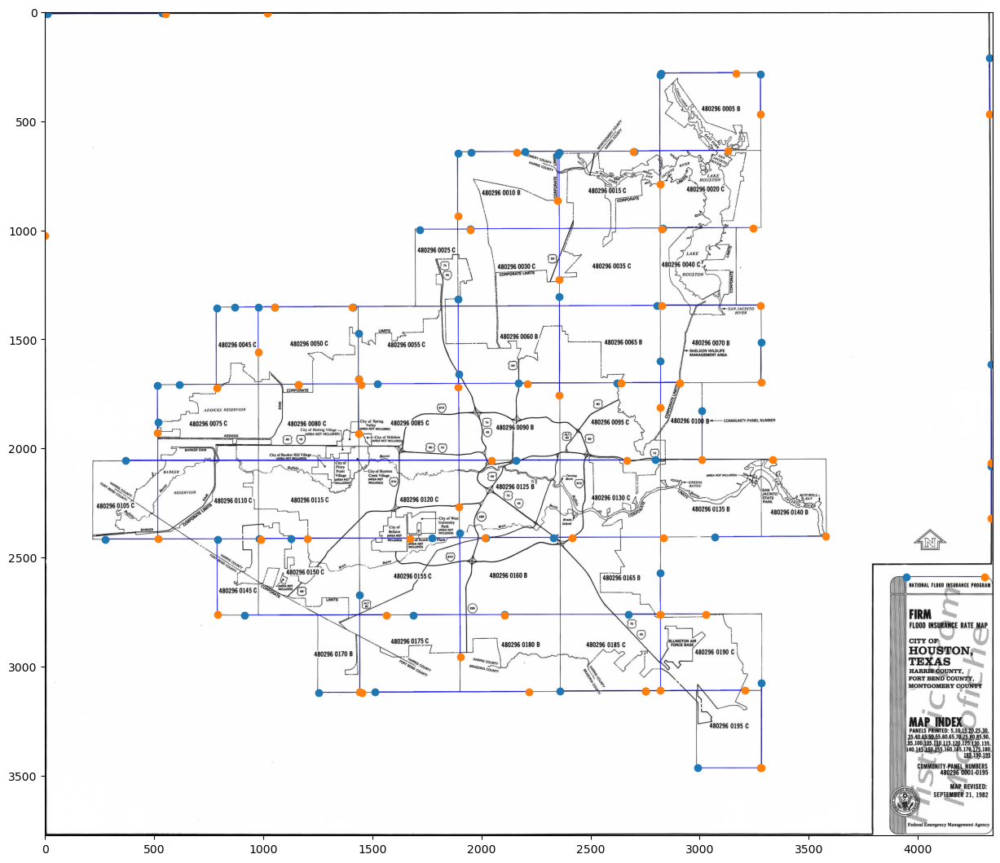

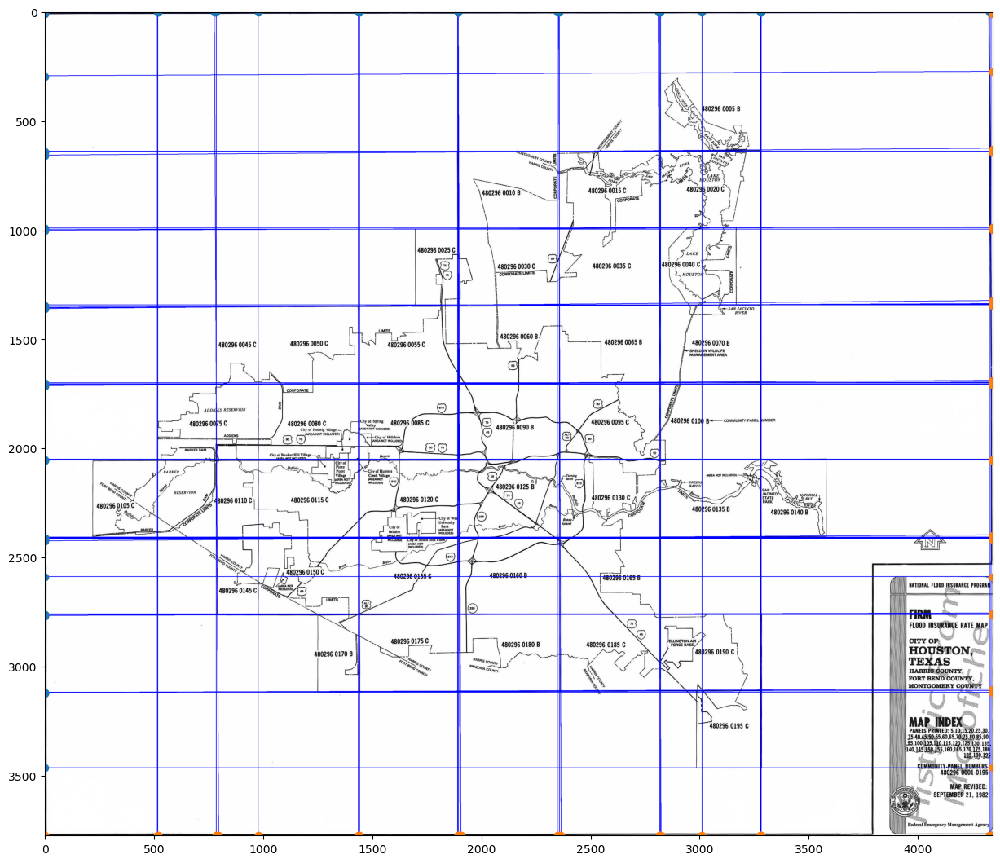

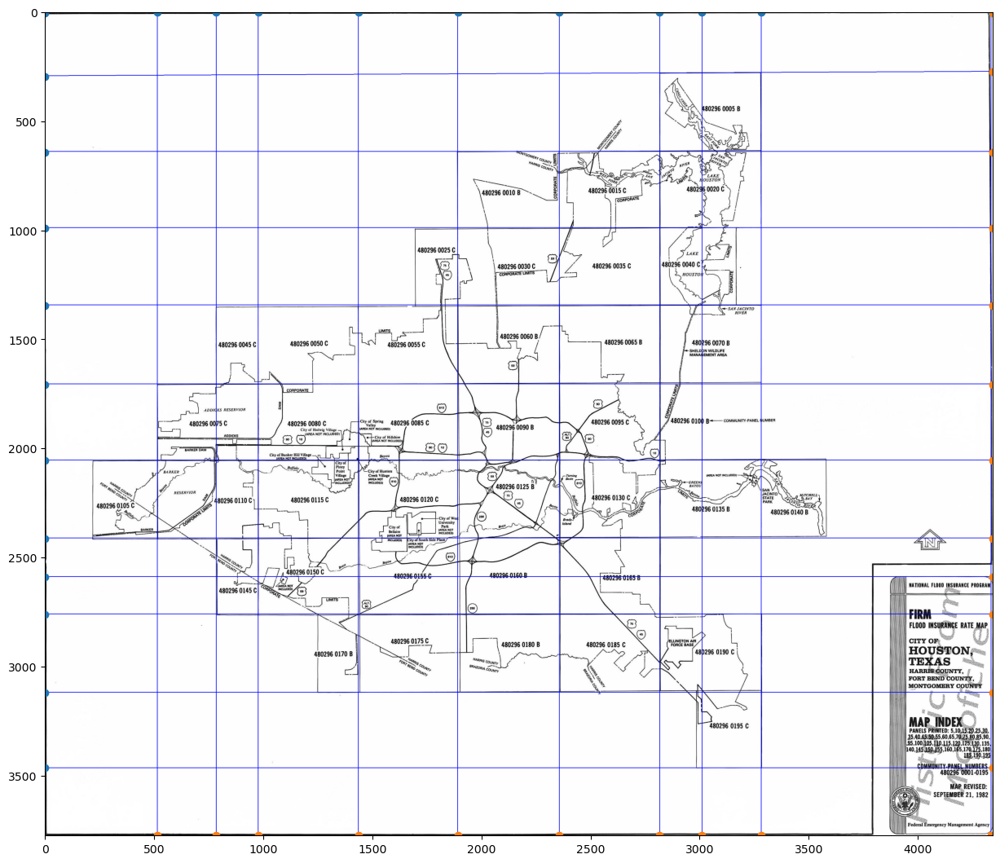

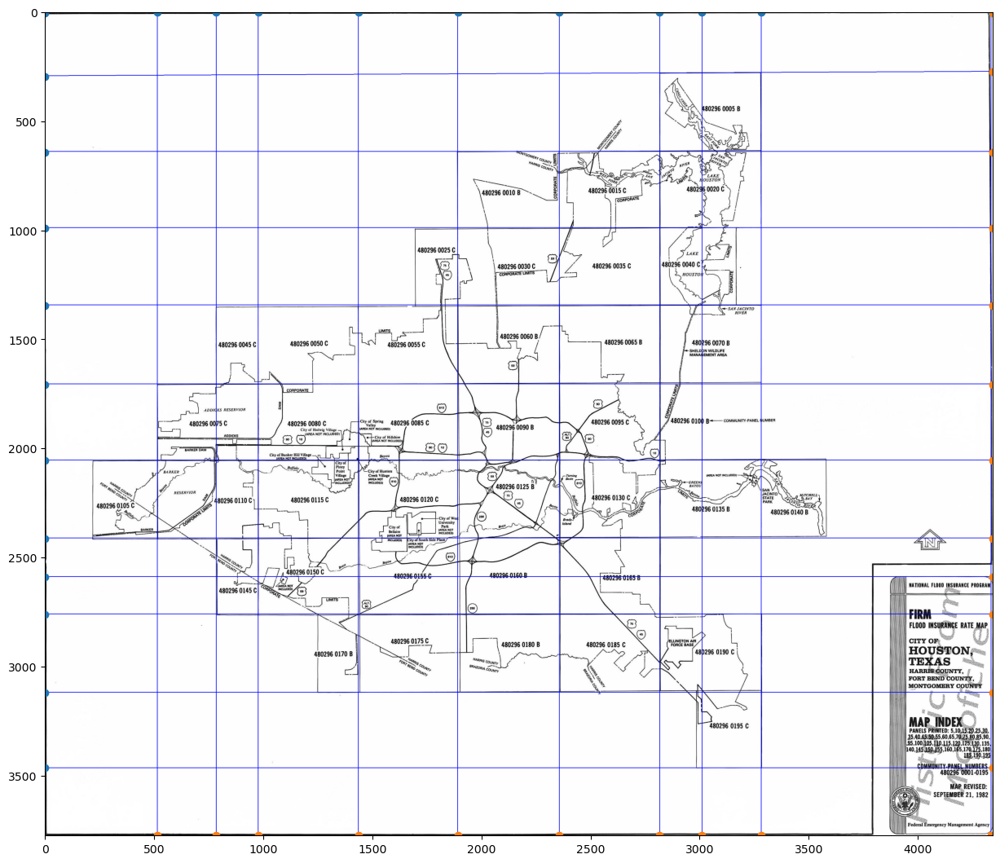

<Figure size 1500x1500 with 0 Axes>

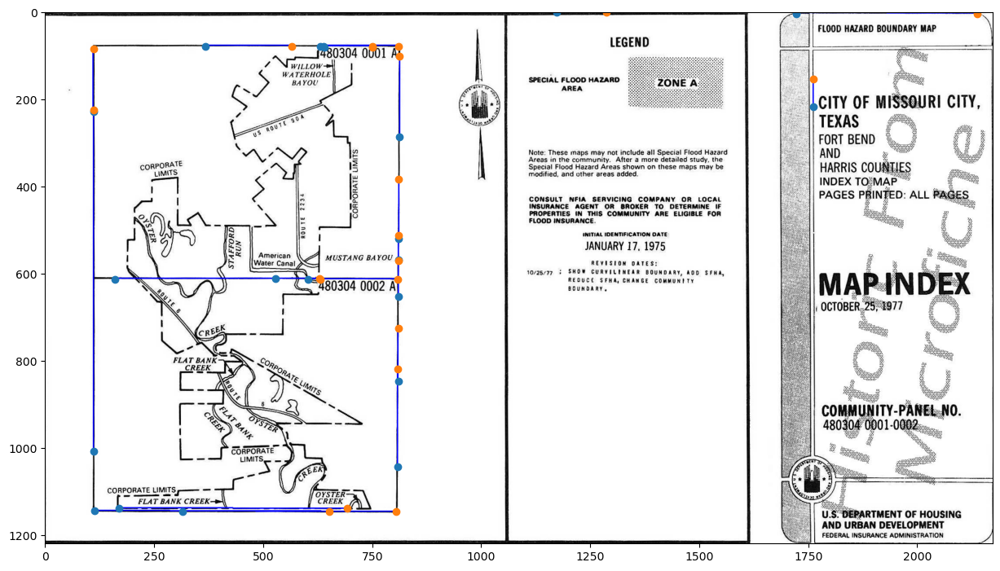

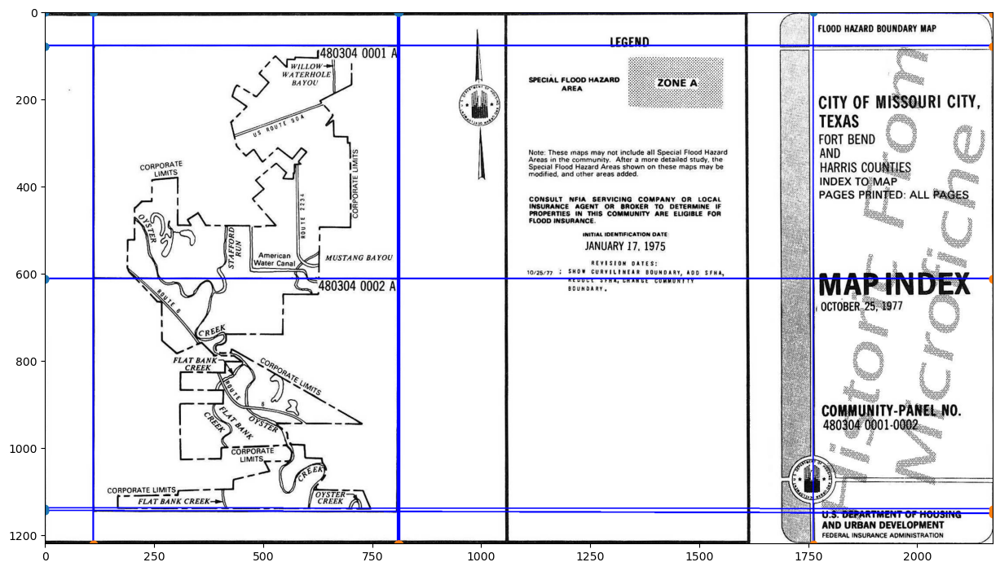

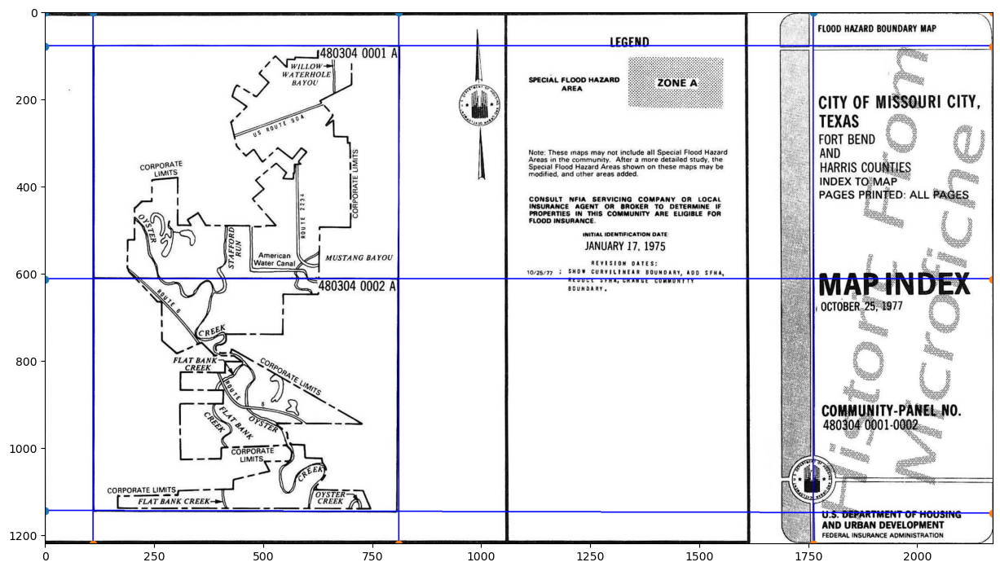

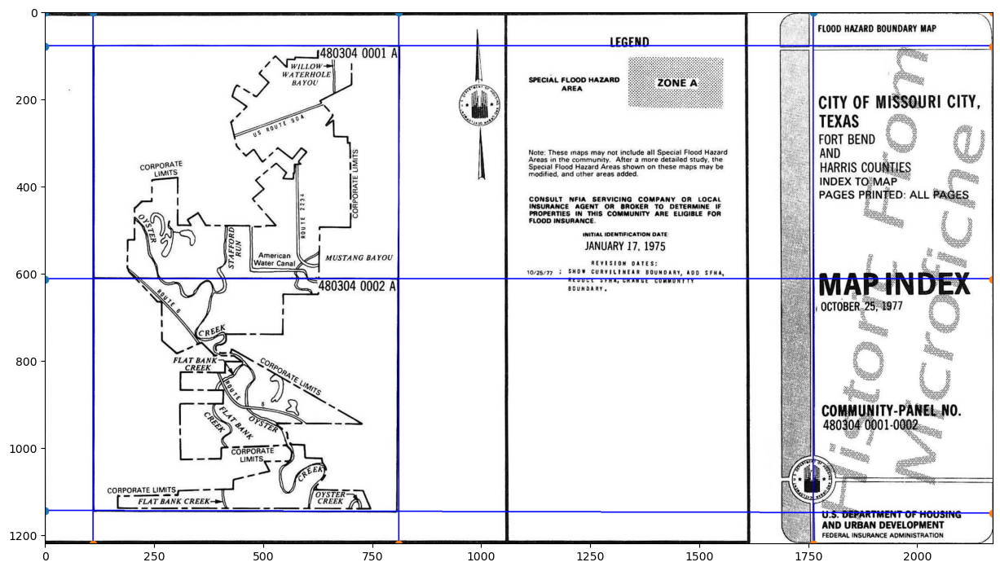

<Figure size 1500x1500 with 0 Axes>

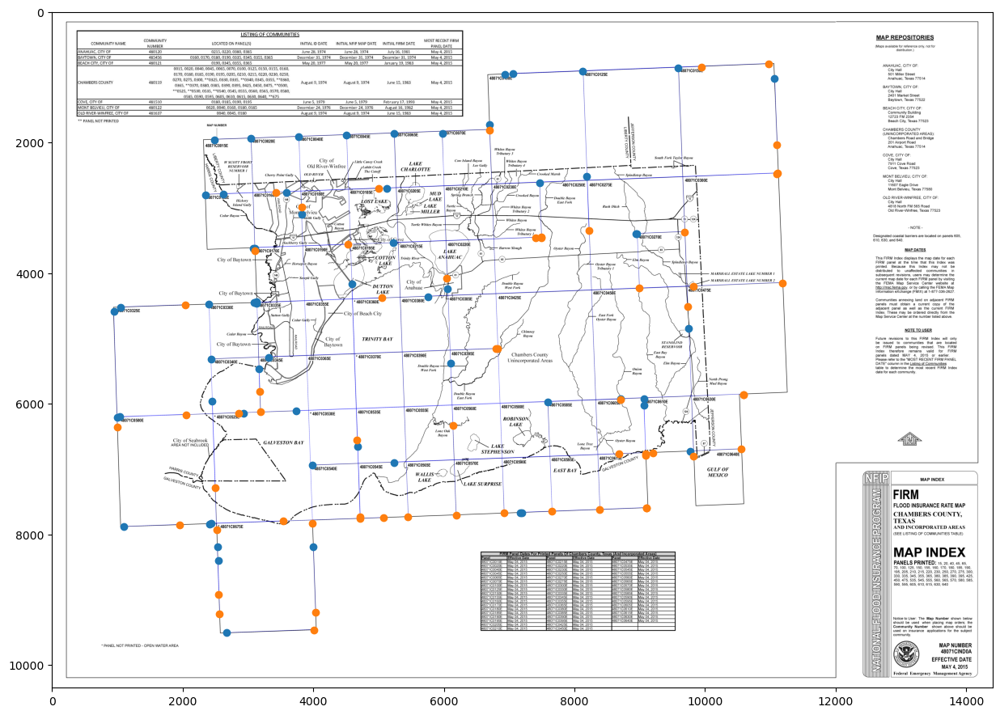

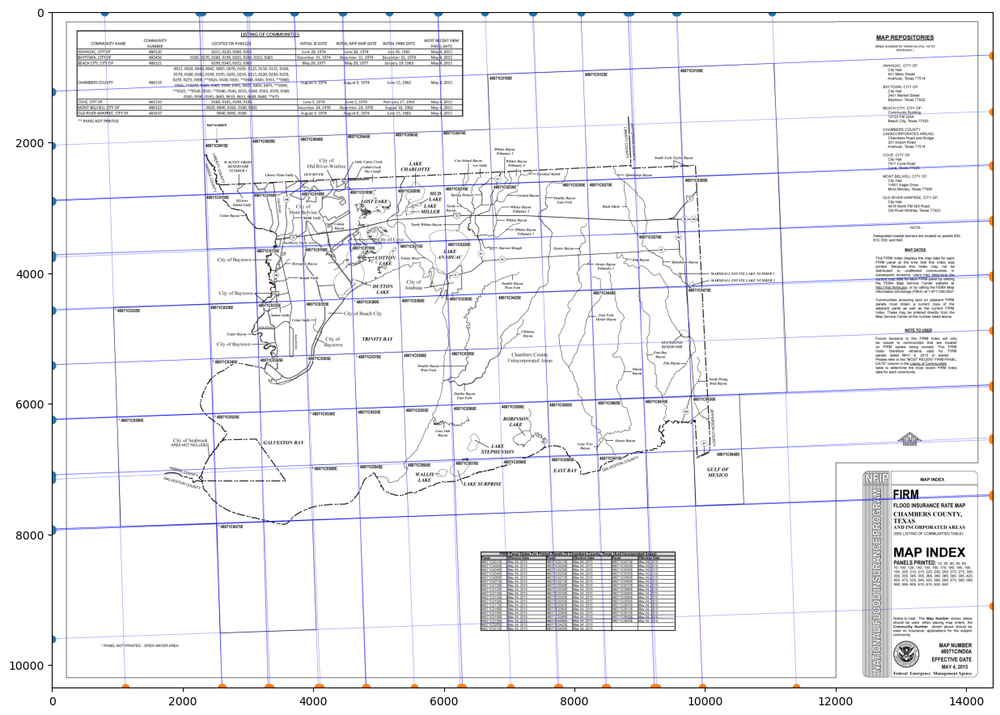

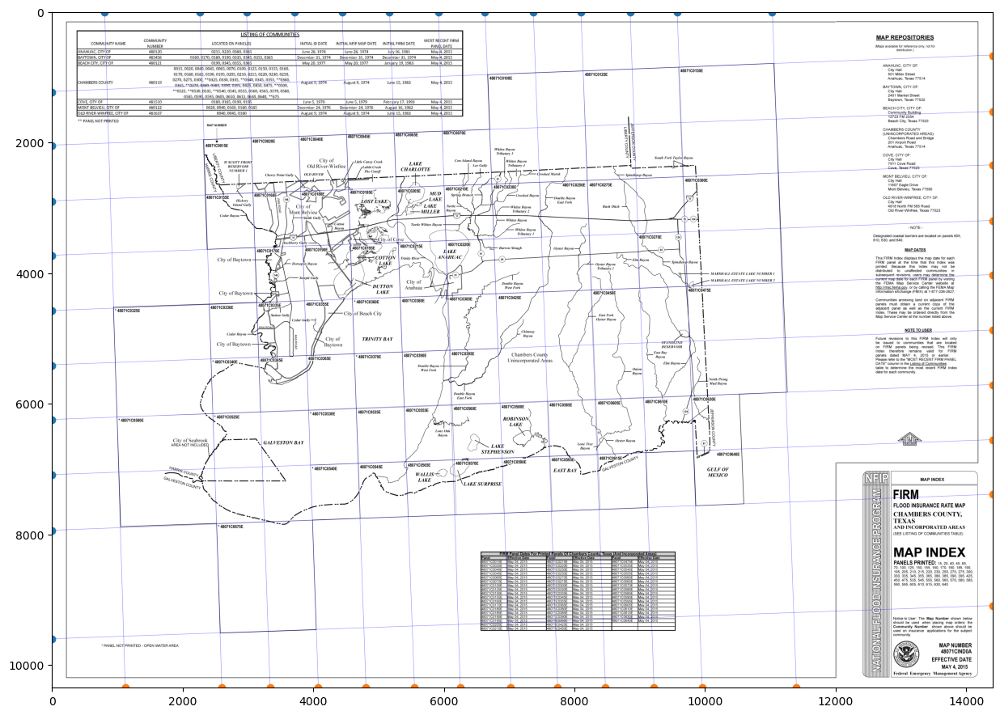

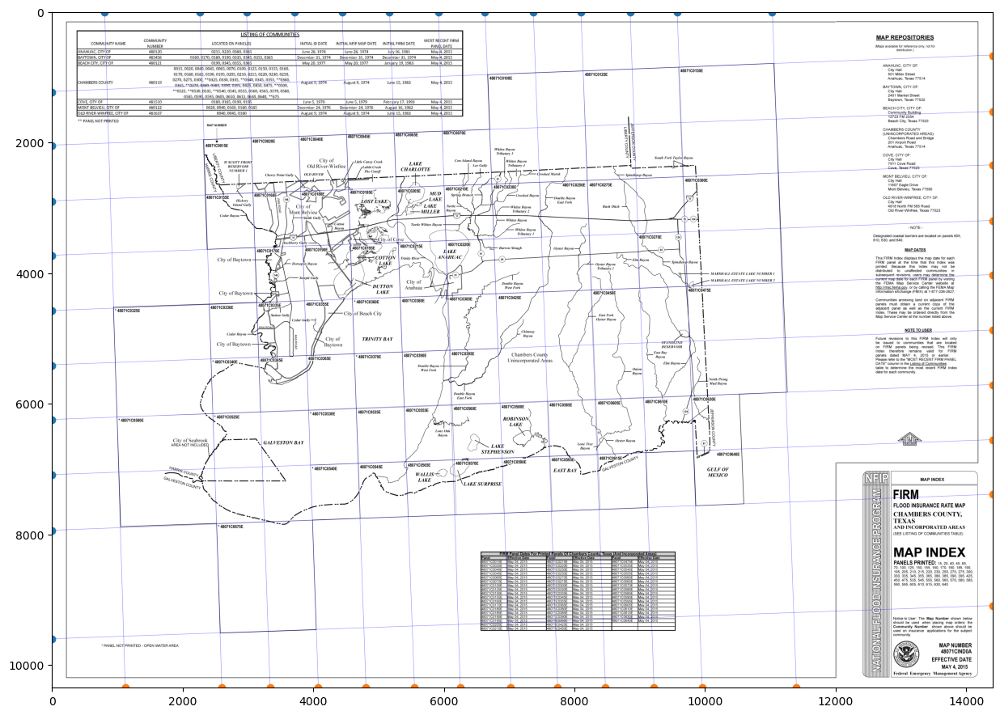

<Figure size 1500x1500 with 0 Axes>

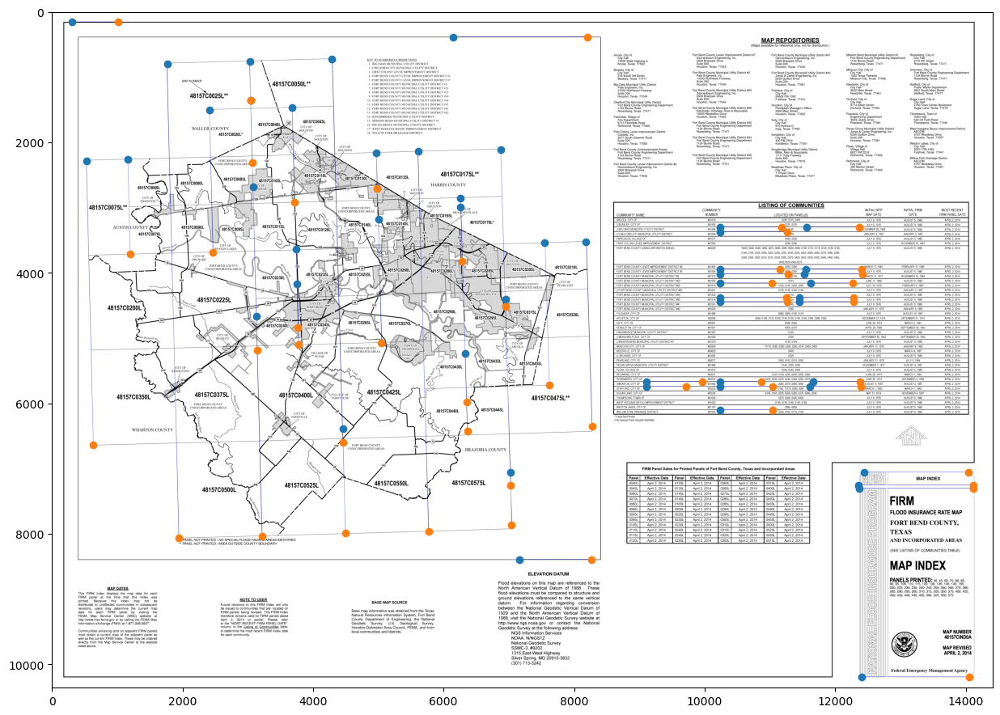

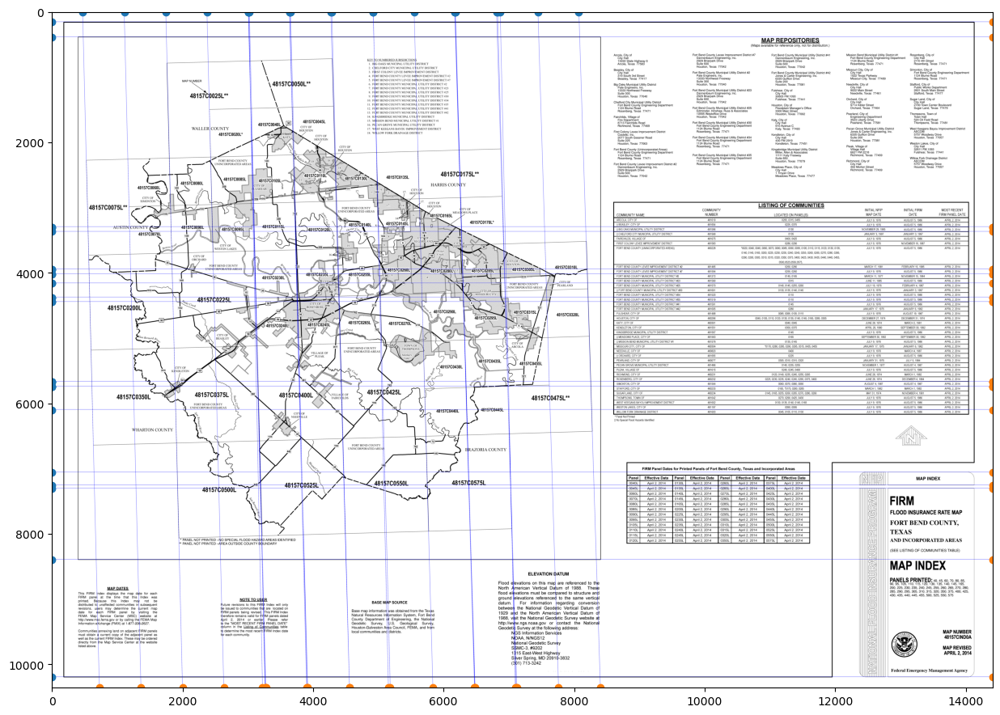

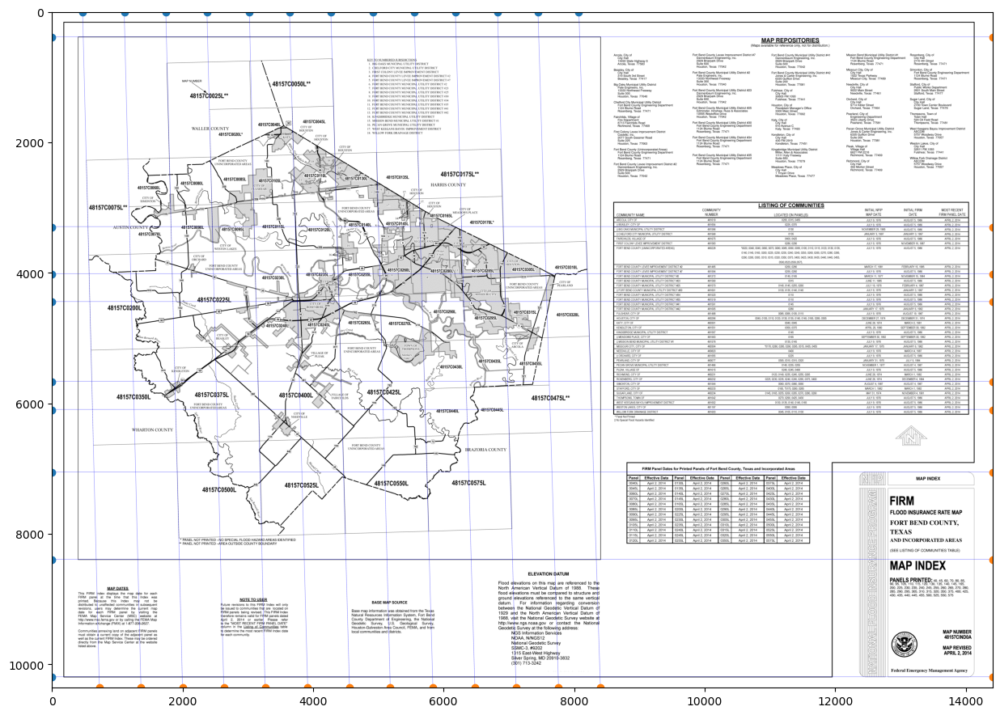

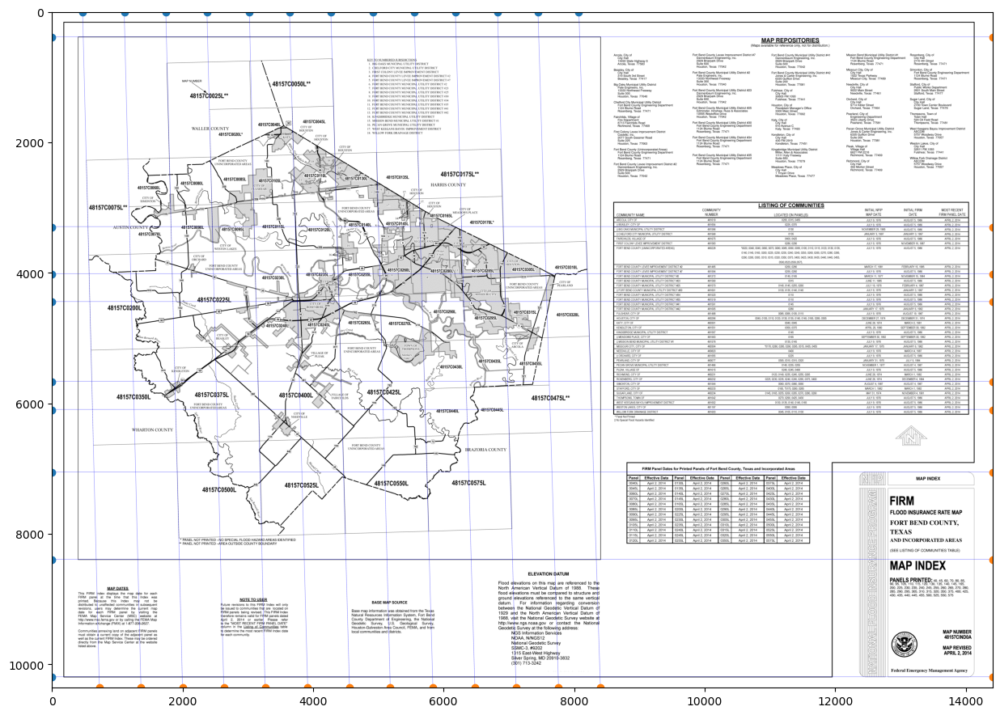

<Figure size 1500x1500 with 0 Axes>

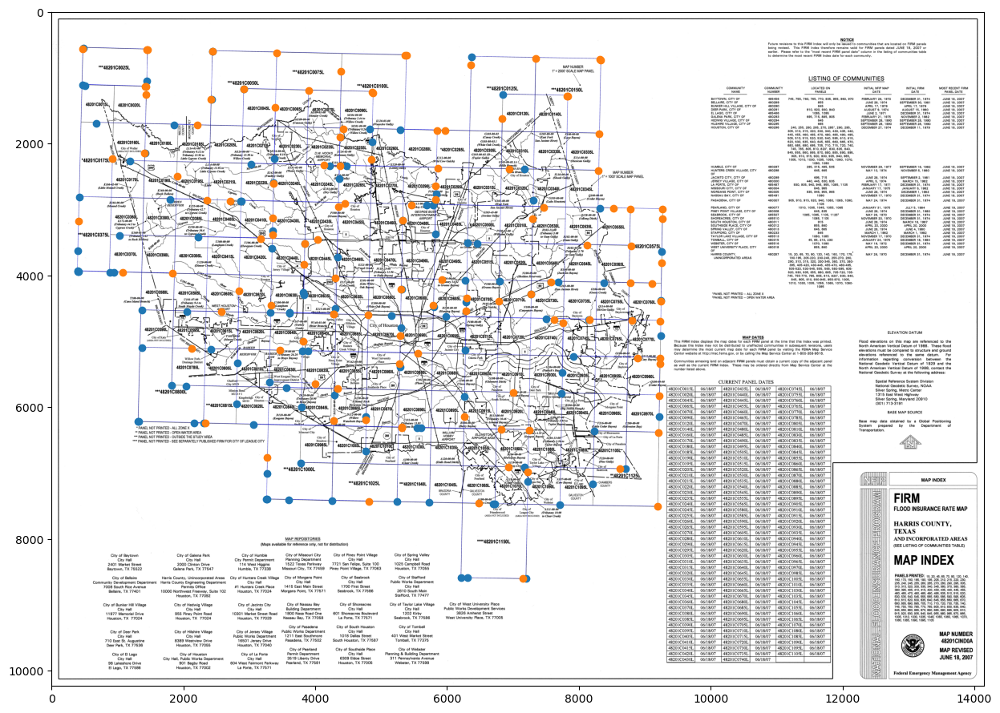

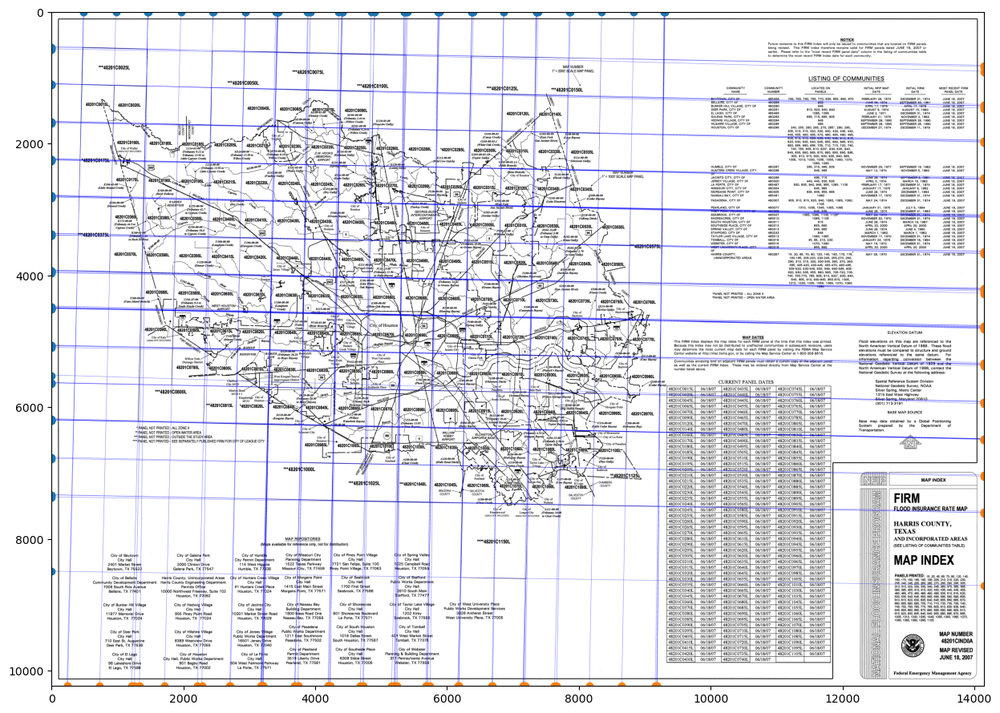

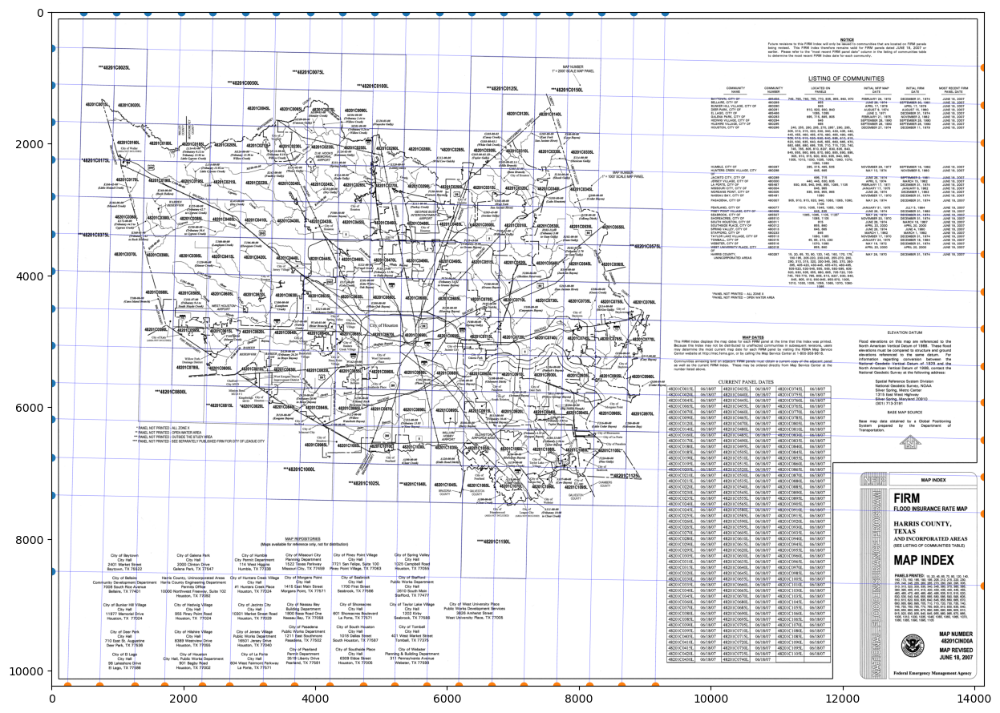

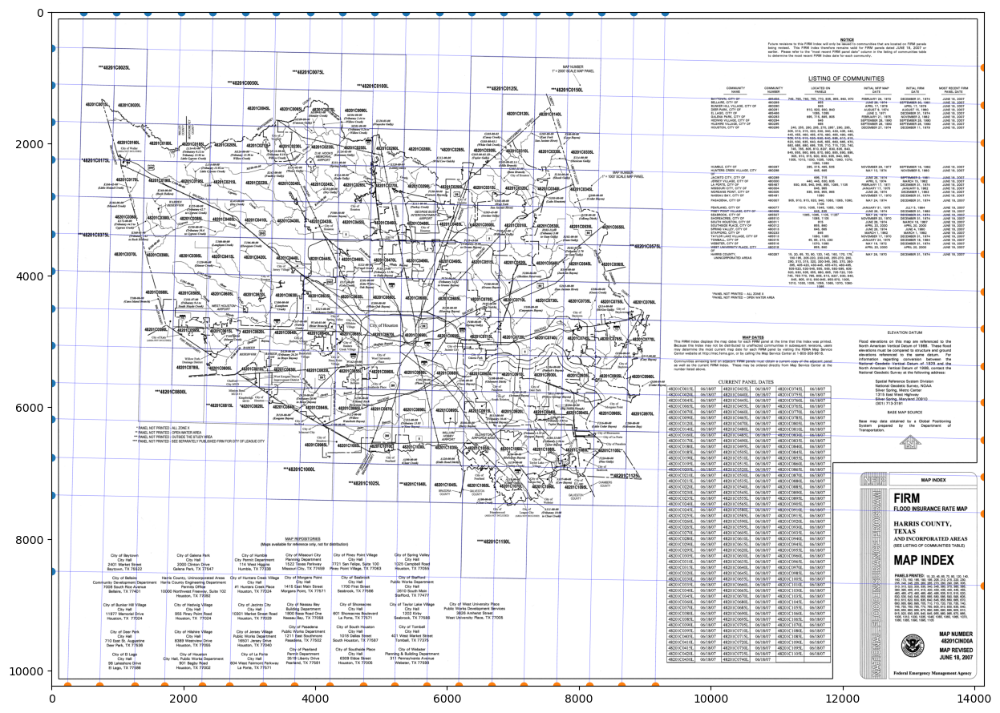

<Figure size 1500x1500 with 0 Axes>

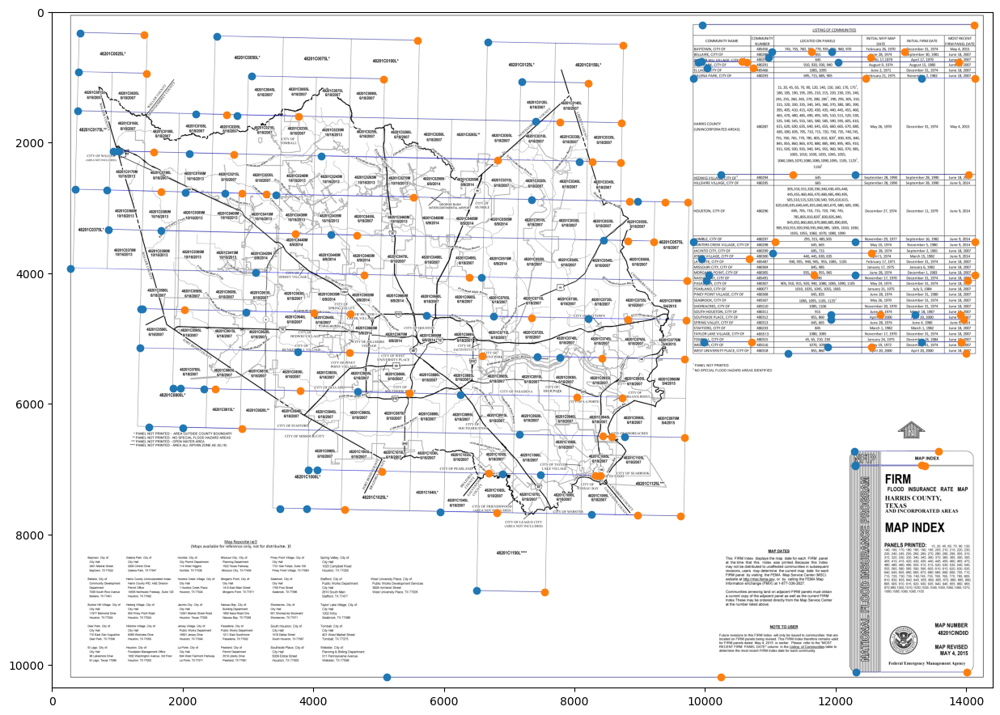

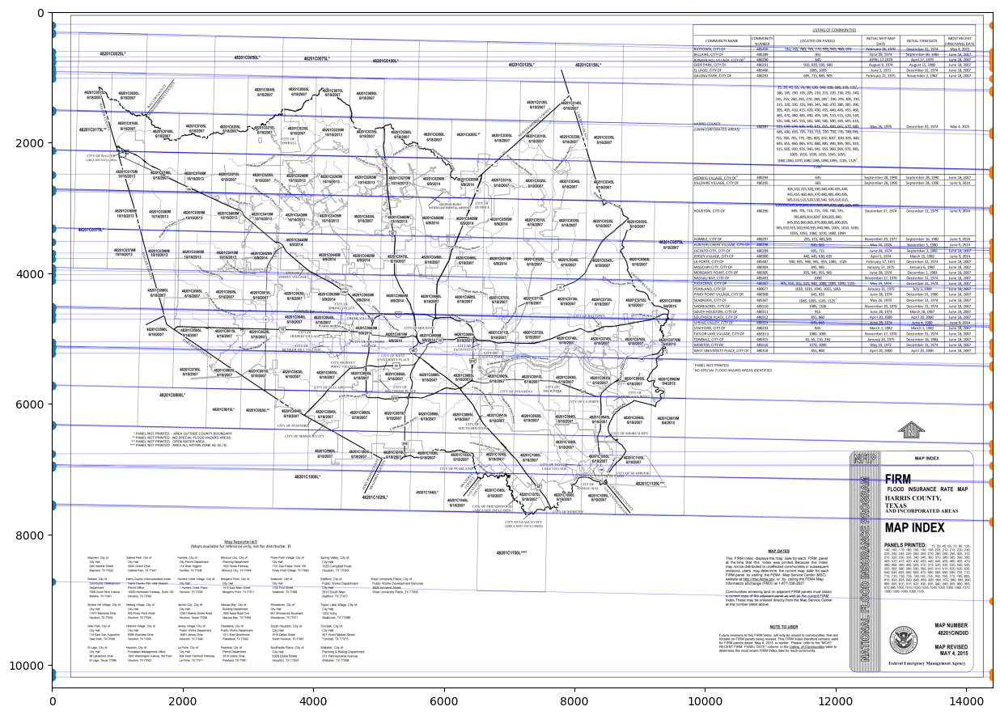

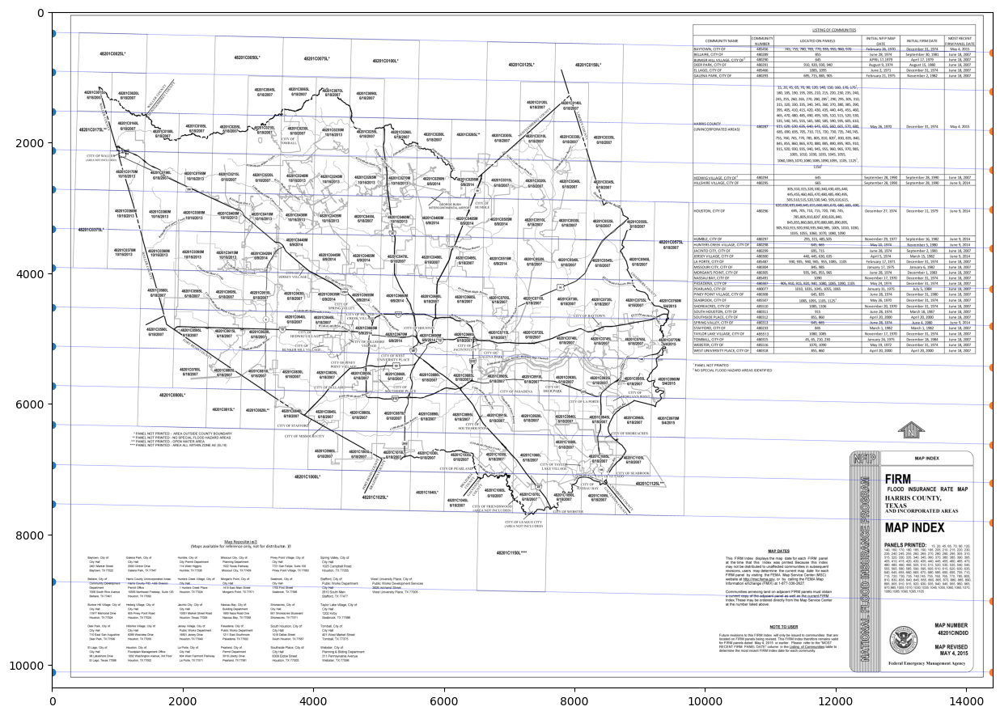

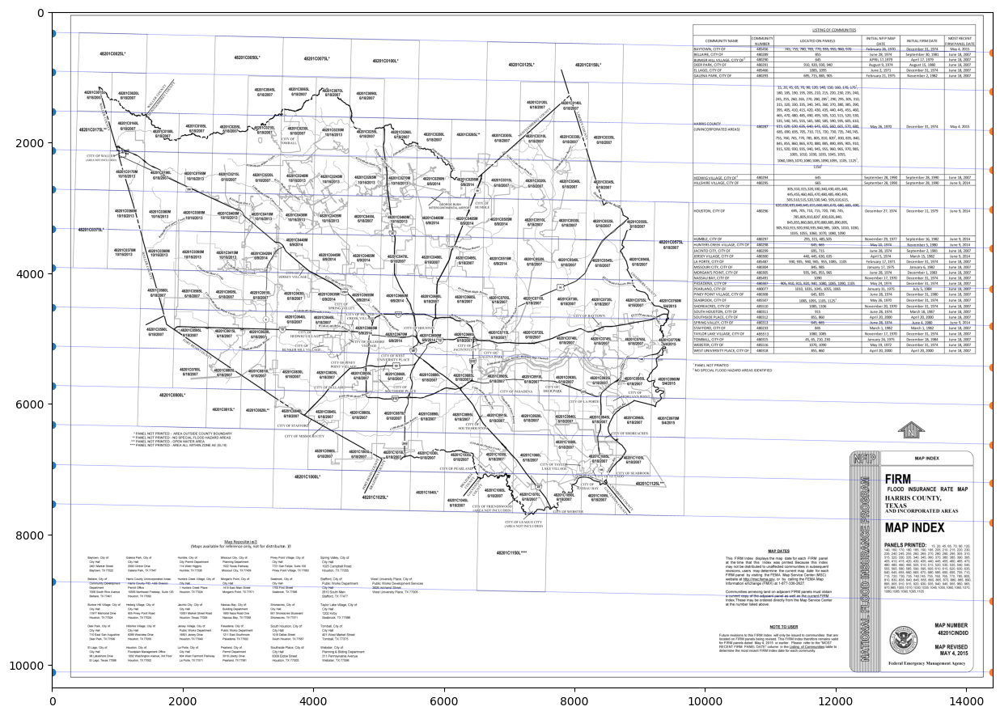

<Figure size 1500x1500 with 0 Axes>

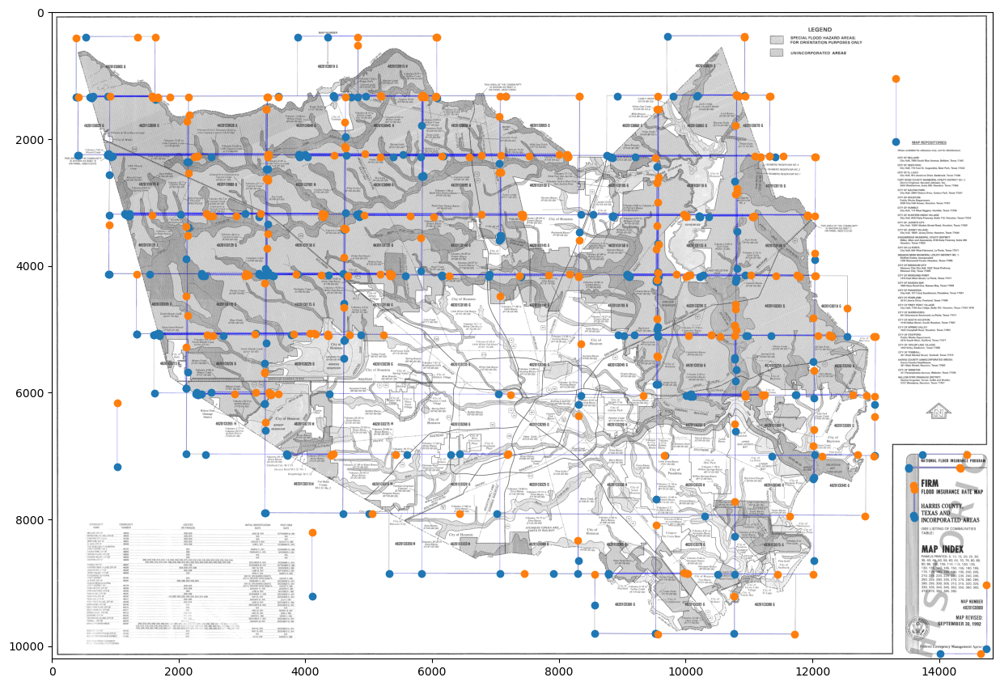

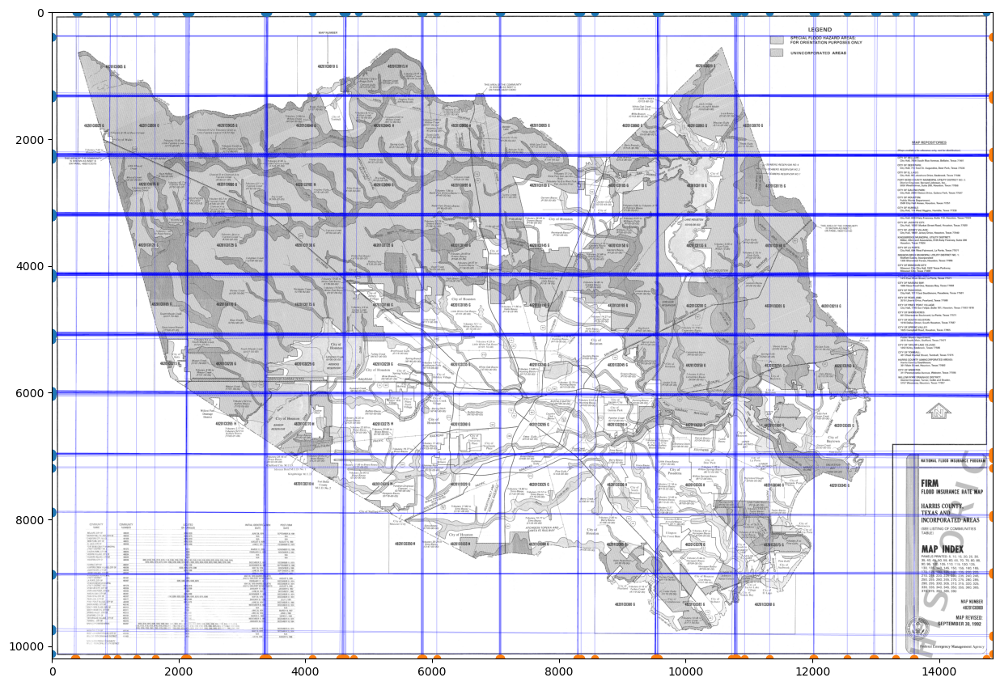

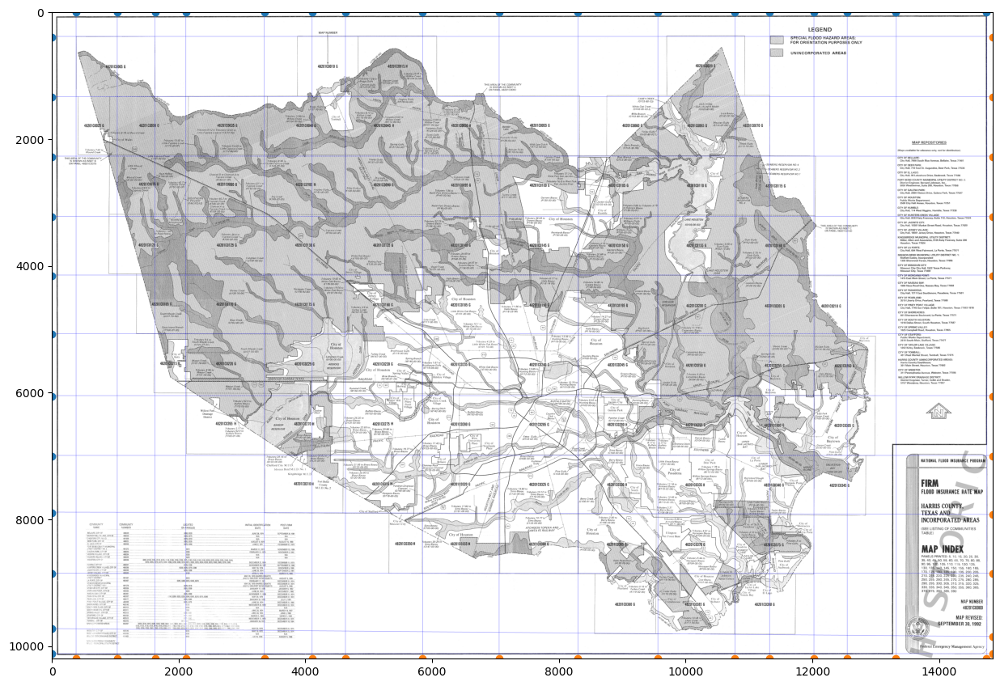

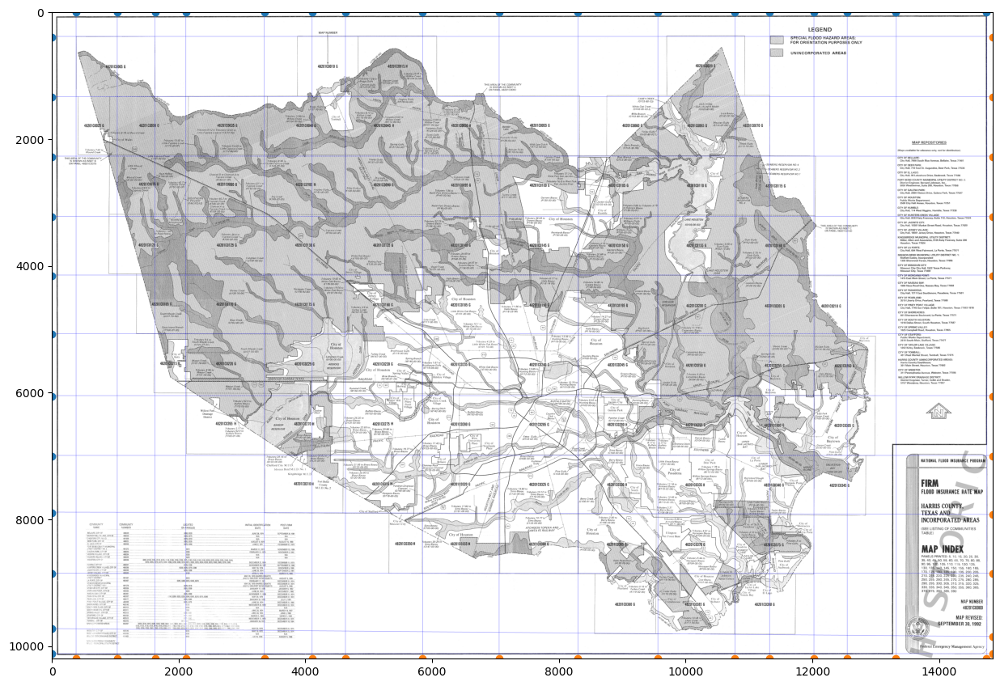

<Figure size 1500x1500 with 0 Axes>

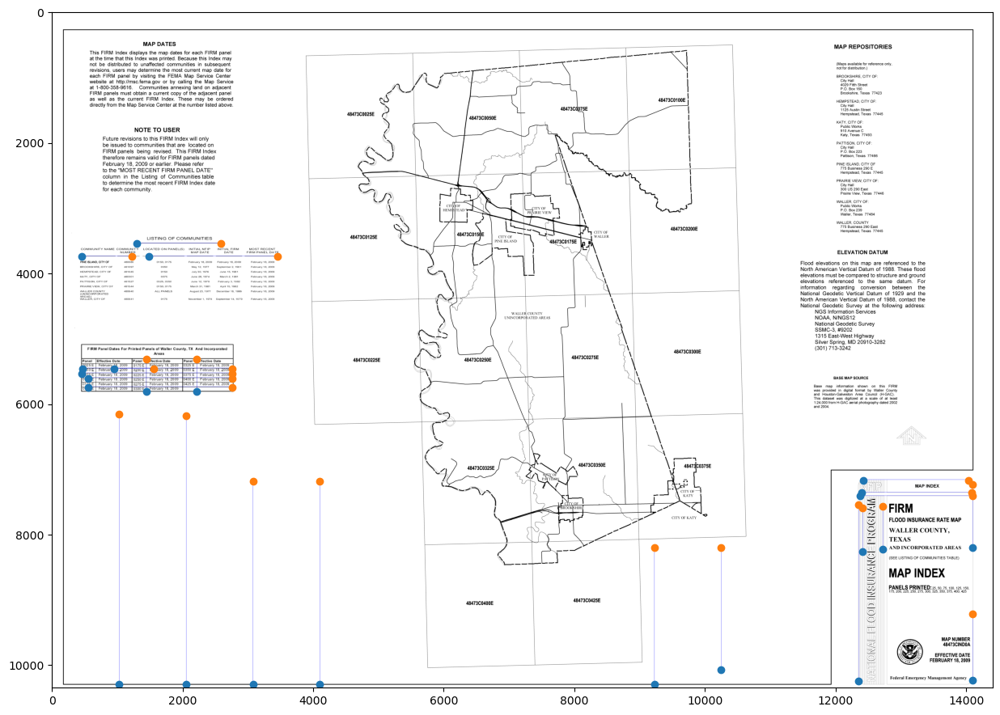

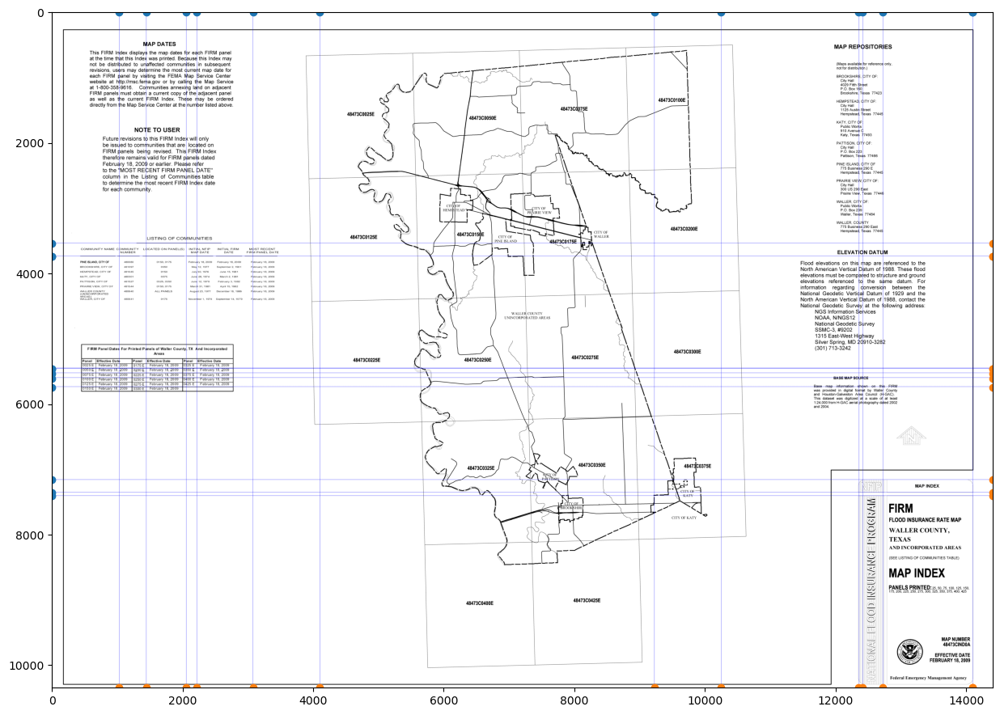

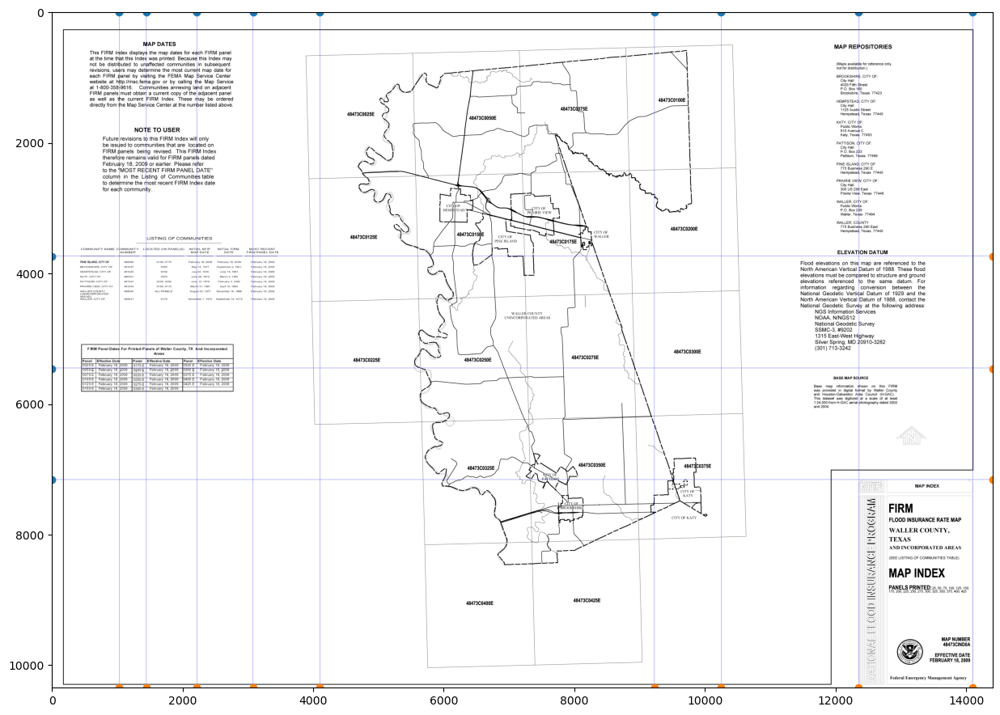

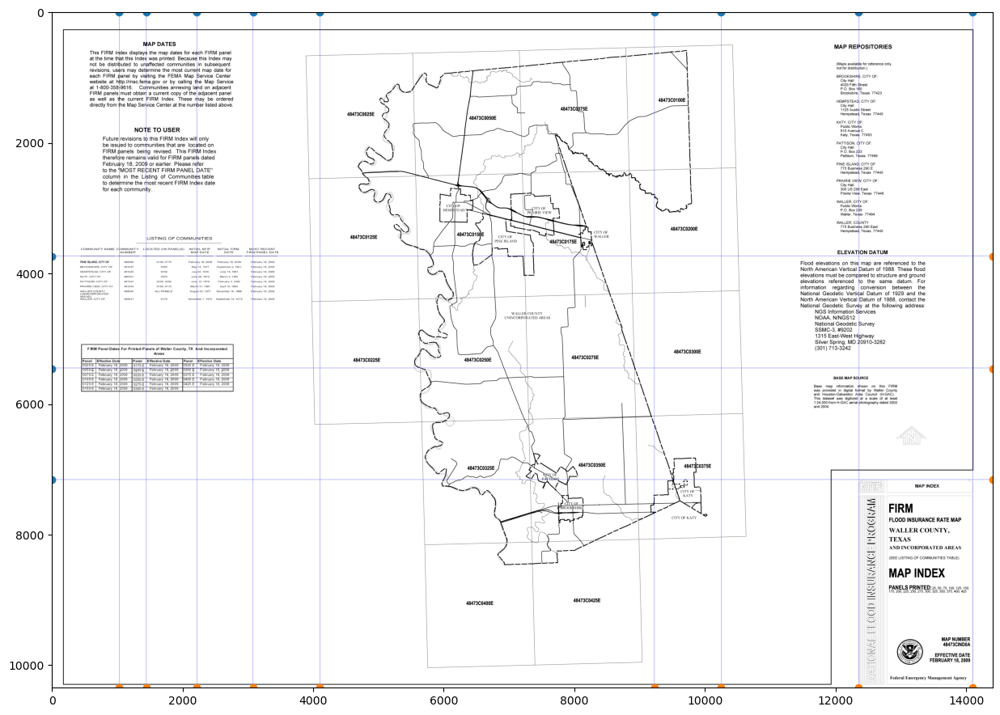

<Figure size 1500x1500 with 0 Axes>

In [3]:
# List all files in the directory
for i, filename in enumerate(os.listdir(prep_folder)):
    image_path = os.path.join(prep_folder, filename)
    if image_path.lower().endswith(('.jpg', '.jpeg', '.png', '.gif', '.tif')):
        
        outdict = FindGrid(image_path)
        if not outdict:
            continue
            
        contour_dict = outdict.copy()
        contours_shapely = {}
        for i, (k, v) in enumerate(contour_dict.items()):
            if isinstance(v, Polygon):
                contours_shapely[k] = v.simplify(tolerance=10)
                continue
            contour_points = [tuple(point[0]) for point in v]
            contours_shapely[k] = Polygon(contour_points).simplify(tolerance=10)
        create_shapefile_from_dict(contours_shapely, f"tempfiles/{i}_{filename[:-4]}.shp")
        

In [4]:
outdict

{'48473CINDOA': array([[[12354,  7163]],
 
        [[12354,  7164]],
 
        [[12354,  7165]],
 
        ...,
 
        [[12357,  7163]],
 
        [[12356,  7163]],
 
        [[12355,  7163]]], dtype=int32)}